## Train full cell-dyn on various models 

In [1]:

import os
os.chdir("T:/laupodteam/AIOS/Chontira/CellDynClustering")
import numpy as np
from sklearn.metrics import silhouette_score, davies_bouldin_score
import pandas as pd
import hdbscan
from evaluation.fast_dunn_index import dunn_fast
from data.load_data import *
from evaluation.util import *
import ast
from sklearn.metrics import f1_score
from graphic_stuffs import *

dm6 = load_data().read_from_path("data/embedded_celldyn_nn50_ndim6.feather",contain_y=False)
param_scores = pd.read_csv("models/cell_dyn_hdbscan_hyper_op_results_20000.csv")
dm6_100000 = load_data().set_df(dm6.df.sample(100000)).get_x_from_df(contain_y=False)
dm6_20000 = load_data().set_df(dm6.df.sample(20000)).get_x_from_df(contain_y=False)
dm6_5000 = load_data().set_df(dm6.df.sample(5000)).get_x_from_df(contain_y=False)
seperated = load_data().read_from_path("data/toy_seperated.csv", contain_y=True)
closed = load_data().read_from_path("data/toy_dense.csv", contain_y=True)

evaluators= {'silhouette_score': silhouette_score,
            'davies_bouldin_score': davies_bouldin_score,
            'dunn_fast': dunn_fast}

dnd= {'davies_bouldin_score': davies_bouldin_score}

db= {'davies_bouldin_score': davies_bouldin_score}


import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.cluster as cluster
import time





In [2]:
# Basic paramters for testing various algorithm
param_robust = {"cut":0.5, "k":1}
param_hd = {"min_cluster_size":50}
best_param =  ast.literal_eval(param_scores["params"].loc[52])

## Training on HDBSCAN

In [12]:
chosen_param = param_hd
model, labels = fit_predict_score(dm6.df,  hdbscan.HDBSCAN, param=chosen_param, evaluators=None)
#plot_predicted_multi_scatter(dm6_20000.df, 12,3,  hdbscan.HDBSCAN, chosen_param)

Unique predicted labels [-1  0  1  2  3  4  5] with their amounts [    486    9318 2185696   39126     375     244    6239]


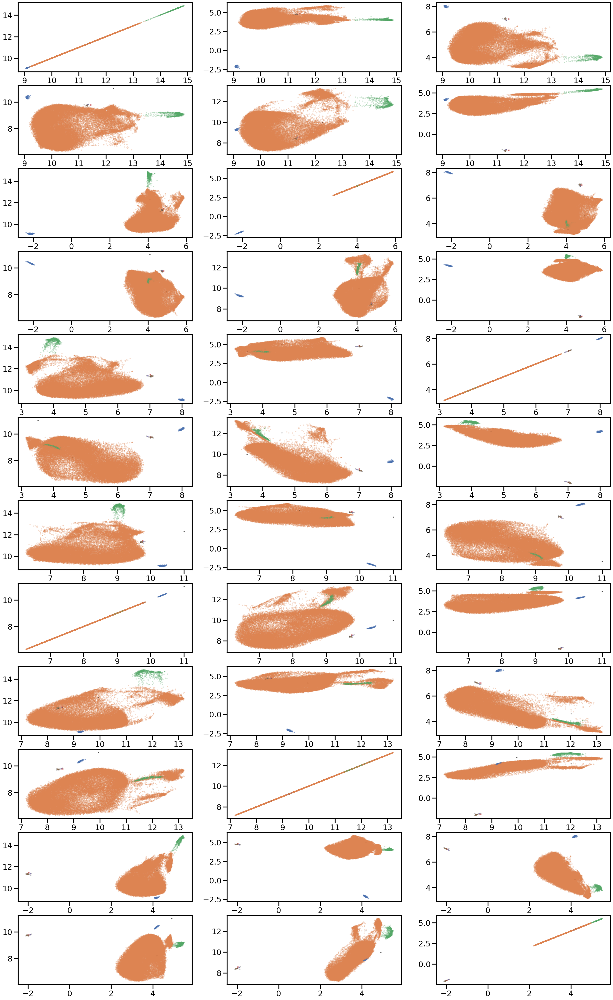

In [35]:
sampled = dm6.df.sample(40000)
#labels[sampled.index]
plot_multi_scatter_with_labels(data=sampled, labels=labels[sampled.index], row=12,col=3)

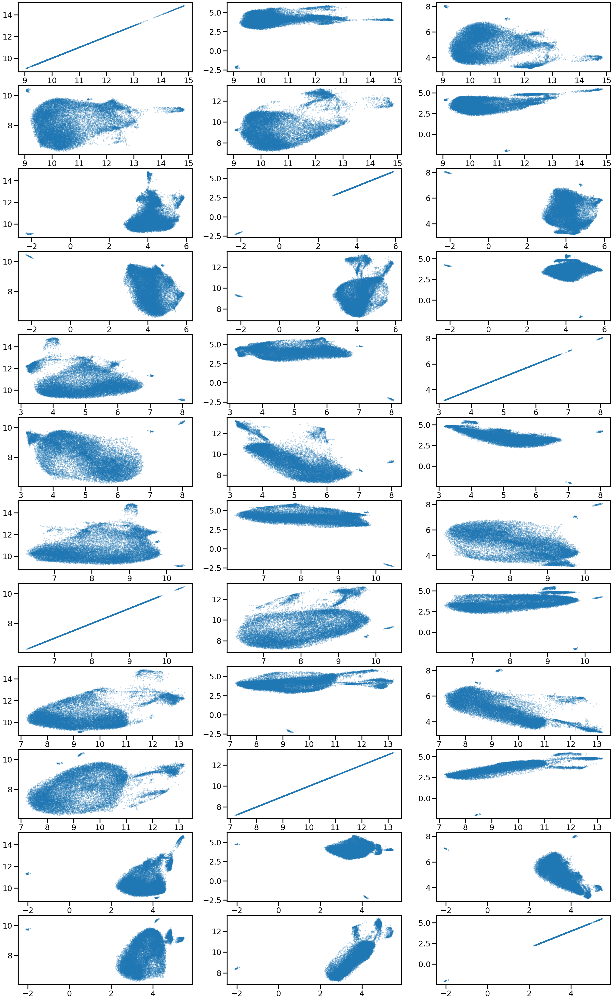

In [33]:
plot_multi_scatter(data=sampled, row=12,col=3)

In [16]:
sampled.iloc[:,0]

1123135    10.193230
227731     10.429988
650854      9.957775
1448014    12.093125
1095717    10.118155
             ...    
1907532    10.410288
1686866    10.007902
1307864     9.736324
1213245    10.052451
1632897    10.454416
Name: dim_1, Length: 20000, dtype: float32

Unique predicted labels [ 0  1  2  3  4  5  6  7  8  9 10] with their amounts [ 2539 10768  3875   842  4978  5578   897  1108   177  4206  5032]
Time taken 3.49 seconds


c:\Users\cchumsae\Anaconda3\envs\CellDynCluster\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


ValueError: 'c' argument has 40000 elements, which is inconsistent with 'x' and 'y' with size 1.

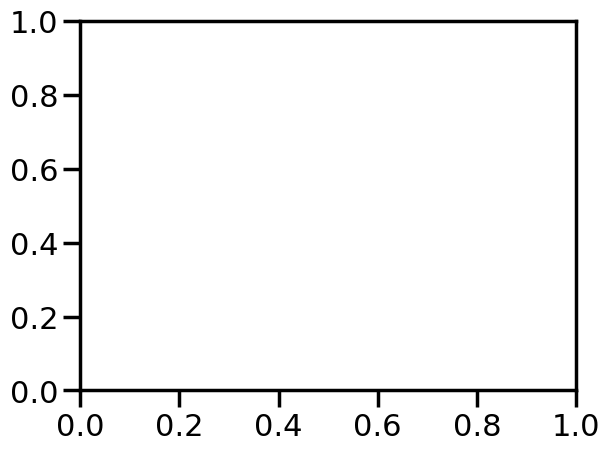

In [4]:
from sklearn.mixture import GaussianMixture

chosen_param = {"n_components" : 11}
sampled = dm6.df.sample(40000)
model, labels = fit_predict_score(sampled,  GaussianMixture, param=chosen_param, evaluators=None)
palette = sns.color_palette('deep', np.unique(labels).max() + 1)
colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
b = sns.scatterplot(sampled.iloc[:,2], sampled.iloc[:,4], color=colors,s = 3, alpha = 0.2)
b.axes.set_title("Component 3 and 5 from embedded Cell-Dyn",fontsize=20)
b.set_xlabel("Component 3",fontsize=20)
b.set_ylabel("Component 5",fontsize=20)
plt.show()
#plt.xlabel("Component 1")
#plt.ylabel("Component 2")


In [8]:
sampled.iloc[:,2]

1882345    4.174652
1608356    5.739731
418112     5.361729
762711     3.375974
31672      4.374728
             ...   
921258     6.240026
946164     6.322005
996720     5.719187
1507999    4.435257
790477     3.715484
Name: dim_3, Length: 40000, dtype: float32

<AxesSubplot:ylabel='$\\lambda$ value'>

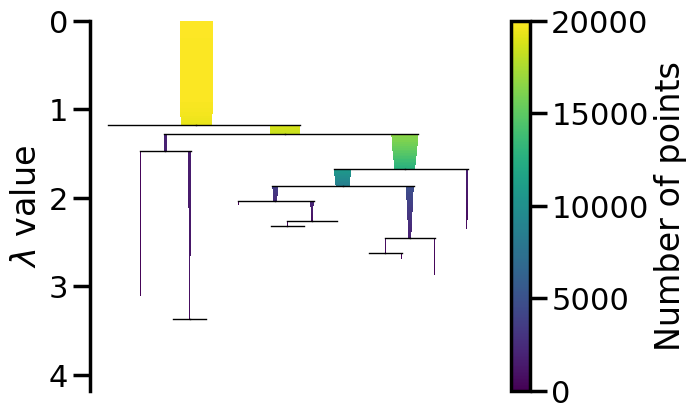

In [13]:
model.condensed_tree_.plot(select_clusters=True)

In [27]:
tmp = model.exemplars_
len(tmp), tmp[0].shape

(4, (100, 6))

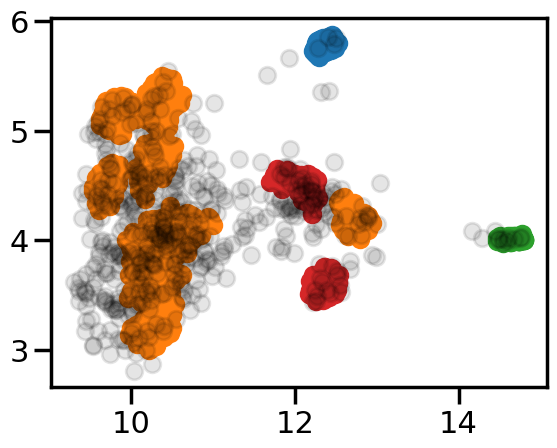

In [44]:
plt.scatter(tmp[0][:,0], tmp[0][:,1])
plt.scatter(tmp[1][:,0], tmp[1][:,1])
plt.scatter(tmp[2][:,0], tmp[2][:,1])
plt.scatter(tmp[3][:,0], tmp[3][:,1])
dm6df = dm6_20000.df.sample(500)
plt.scatter(dm6df.iloc[:,0], dm6df.iloc[:,1], color='black', alpha=0.1)

## full data

In [3]:
dm6.X.shape

(2241484, 6)

In [5]:
chosen_param = param_hd
model, labels = fit_predict_score(dm6.df,  hdbscan.HDBSCAN, chosen_param, db)
#plot_predicted_multi_scatter(dm6.df, 12,3,  hdbscan.HDBSCAN, chosen_param)

Metric                   Score
--------------------  --------
davies_bouldin_score  0.342008


Unique predicted labels [0 1 2] with their amounts [   9318 2224884    7282]


## Trying RobustSingleLinkage from HDBSCAN lib 

Metric                     Score
--------------------  ----------
silhouette_score      -0.387899
davies_bouldin_score   1.43133
dunn_fast              0.0197758


Unique predicted labels [0 1 2 3 4 5 6 7 8] with their amounts [    6 17502     5    87  1619     5    99     8   555]


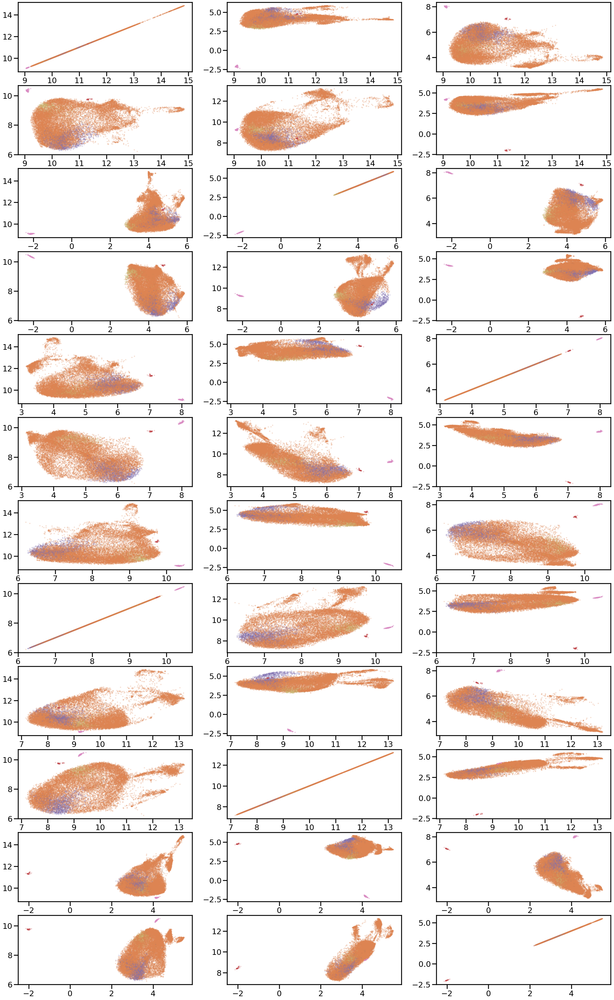

In [17]:
chosen_param = param_robust
model, labels = fit_predict_score(dm6_20000.X,  hdbscan.RobustSingleLinkage, chosen_param, evaluators, remove_noise=True)
plot_predicted_multi_scatter(dm6_20000.df, 12,3,  hdbscan.RobustSingleLinkage, chosen_param, remove_noise=True)

## Trying flat cut from HDBSCAN

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]), array([6254,   99,   87,  573,  336,   12,   13,   15, 9605,   15, 1364,
       1627], dtype=int64))
Metric                      Score
--------------------  -----------
silhouette_score      -0.112095
davies_bouldin_score   2.55417
dunn_fast              0.00580753




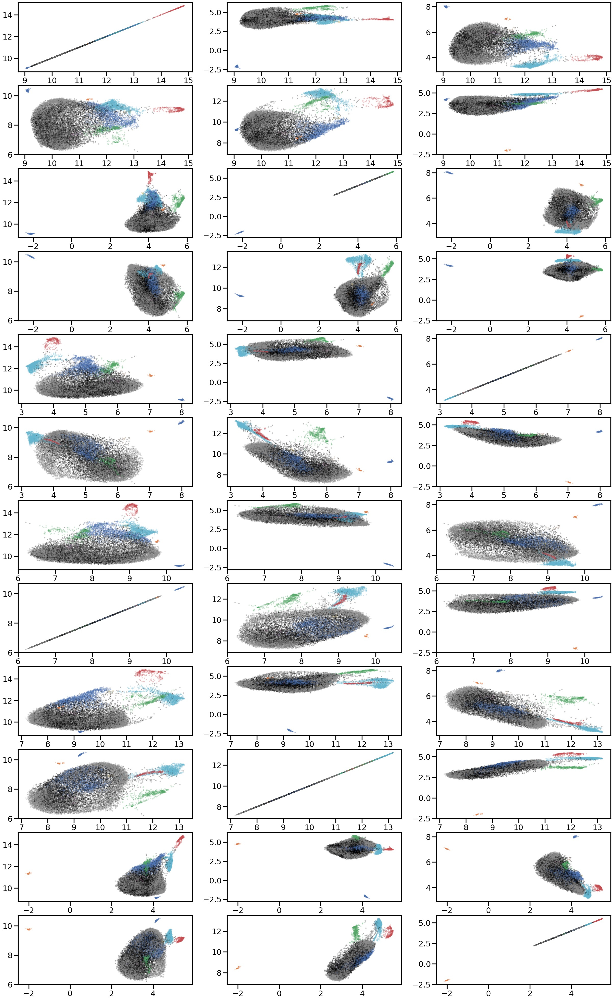

In [22]:

from hdbscan import flat

clusterer = flat.HDBSCAN_flat(dm6_20000.X, 11,prediction_data=True, cluster_selection_method = 'leaf', min_cluster_size = 10)
predicted = flat.approximate_predict_flat(clusterer, dm6_20000.X)[0]
print(np.unique(predicted, return_counts=True))
metrics_scores_dict(dm6_20000.X, predicted, evaluators, verbose=True)
plot_multi_scatter_with_labels(dm6_20000.df,predicted, 12, 3)

## Trying dynamic tree cut

In [24]:
from dynamicTreeCut import cutreeHybrid
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage

distances = pdist(dm6_20000.X, "euclidean")
link = linkage(distances, "average")
clusters = cutreeHybrid(link, distances)
metrics_scores_dict(dm6_20000.X, clusters["labels"], evaluators, verbose=True)



..cutHeight not given, setting it to 7.757039424592133  ===>  99% of the (truncated) height range in dendro.
..done.
Metric                   Score
--------------------  --------
silhouette_score      0.331784
davies_bouldin_score  0.794958
dunn_fast             0.029081




In [25]:
print(np.unique(clusters["labels"], return_counts=True))

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int64), array([5237, 3197, 2453, 2421, 2402, 1748, 1408,  603,  345,   99,   87],
      dtype=int64))


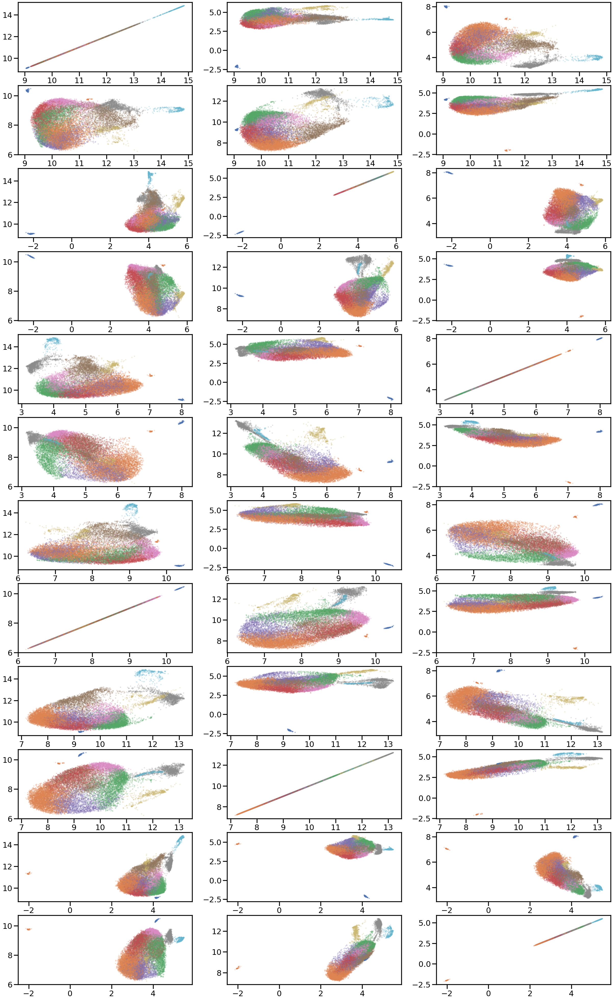

In [26]:
plot_multi_scatter_with_labels(dm6_20000.df,clusters["labels"], 12, 3)

## Trying Gaussian Mixture

Metric                     Score
--------------------  ----------
silhouette_score      0.334337
davies_bouldin_score  0.945764
dunn_fast             0.00852369


Unique predicted labels [ 0  1  2  3  4  5  6  7  8  9 10] with their amounts [3461  159 1937 5716  472  561 2567 1654   99 1280 2094]


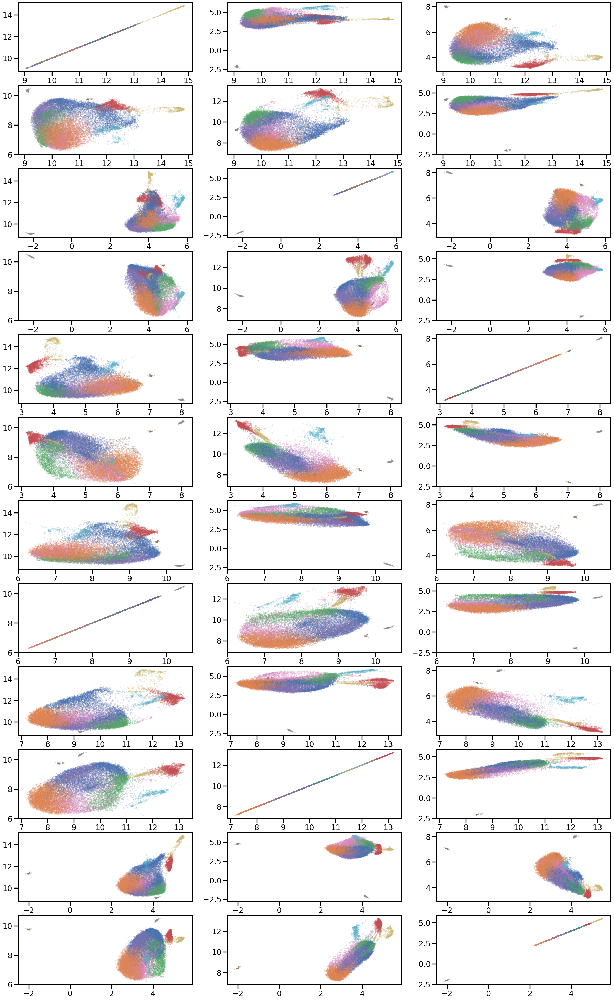

In [27]:
from sklearn.mixture import GaussianMixture

chosen_param = {"n_components" : 11}
model, labels = fit_predict_score(dm6_20000.X,  GaussianMixture, chosen_param, evaluators, remove_noise=False)
plot_predicted_multi_scatter(dm6_20000.df, 12,3, GaussianMixture, chosen_param, remove_noise=False)